### Planned steps:
- gather data - 15 min.
- EDA - 1 hour
- understand problem - define goal in ML terms [part of EDA]
- data prep - 1 hour
- base model/dummy model - skipped
- Feature engineering - 3 hours + (compute time)
- data prep for modeling +  base model - 1 hour
<br>**6 hours mark**
- estimator selection / fine tunning - not finished
- save model + artifacts (30 minutes)
- upload model as REST API

### Gather data

In [12]:
# !curl -o data.zip "https://github.com/datamole-ai/AirPressure/blob/main/data.zip?raw=true" -L -o a.zip

# from zipfile import ZipFile

# file_name = "data.zip"

# with ZipFile(file_name, 'r') as zip:
#     # extracting all the files
#     zip.extractall()

In [9]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_parquet("data.parquet")
labels = pd.read_csv("labels.csv")

In [28]:
df.head()

,MachineId,MeasurementId,Pressure
0,0_0_0,0,0.0
1,0_0_0,0,0.0
2,0_0_0,0,0.0
3,0_0_0,0,0.0
4,0_0_0,0,0.0


In [29]:
labels.head()

,MachineId,MeasurementId,PumpFailed,SlowStart,SlowEnd
0,0_0_0,0,False,False,False
1,0_0_1,-1,NaN,NaN,NaN
2,0_0_2,0,False,False,False
3,0_0_3,0,True,False,False
4,0_1_0,-1,NaN,NaN,NaN


### EDA 
- labels

In [37]:
labels.nunique()

MachineId         556
MeasurementId    8836
PumpFailed          2
SlowStart           2
SlowEnd             2
dtype: int64

Note: seems that each machine has several related measurements

In [34]:
labels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27385 entries, 0 to 27384
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   MachineId      27385 non-null  object
 1   MeasurementId  27385 non-null  int64 
 2   PumpFailed     26900 non-null  object
 3   SlowStart      19300 non-null  object
 4   SlowEnd        19300 non-null  object
dtypes: int64(1), object(4)
memory usage: 1.0+ MB


Note: there are missing labels for PumpFailed label - we will need to drop those records

In [35]:
labels["PumpFailed"].value_counts()

False    23958
True      2942
Name: PumpFailed, dtype: int64

Note: 
I am dealing with unbalanced dataset.

In [66]:
labels["MeasurementId"].value_counts()

-1       485
 6640      4
 2828      4
 6325      4
 6326      4
        ... 
 5617      1
 7759      1
 7758      1
 5183      1
 4392      1
Name: MeasurementId, Length: 8836, dtype: int64

Note: Measurement ID is not unique

In [4]:
labels[labels["MeasurementId"]==6640]

,MachineId,MeasurementId,PumpFailed,SlowStart,SlowEnd
19472,4_0_0,6640,False,NaN,NaN
19473,4_0_1,6640,False,NaN,NaN
19474,4_0_2,6640,False,NaN,NaN
19475,4_0_3,6640,False,NaN,NaN


In [44]:
labels.groupby(by=["MachineId","MeasurementId"]).count().max()

PumpFailed     1
SlowStart      1
SlowEnd        1
combination    1
dtype: int64

Note: Combination of MeasurementId and MachineId is unique - I'll use this as identifier

In [12]:
labels["MachineId"].value_counts()

0_2_1     970
0_2_2     948
0_2_3     917
0_2_0     867
0_1_2     672
         ... 
51_5_0      1
51_5_1      1
51_5_2      1
51_5_3      1
38_2_2      1
Name: MachineId, Length: 556, dtype: int64

MachineId can be used also as variable but we need to be carefull as it is quite distinct categorical variable and it could lead to overfitting for machines with no historical Pump failures.

In [25]:
## function to get Measurements data for each combination
def get_measurement_data(combination):
    (machine_id, measurement_id) = combination
    new_df = df[(df["MachineId"]==machine_id) & (df["MeasurementId"]==measurement_id)]
    return new_df["Pressure"].values

# get_measurement_data(["4_0_1", 6640])

In [67]:
labels_refined = labels.dropna(subset=["PumpFailed"]).copy()

# check if we dropped all MeasurementId==-1 with dropna command
# labels_refined["MeasurementId"].value_counts()[-1]        # we dropepd it


### EDA for measurements:



In [43]:
df.groupby(by=["MachineId","MeasurementId"]).count()

Pressure
MachineId MeasurementId          
0_0_0     0                   368
          215                 732
          237                 589
          353                 349
          411                 373
...                           ...
9_5_3     4253                337
          4254                478
          4255                436
          4256                549
          4257                380

[26900 rows x 1 columns]

In [ ]:
df.groupby(by=["MachineId","MeasurementId"]).min()

False
False
True
True
True
True


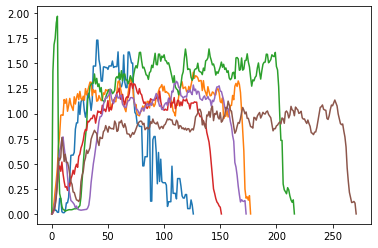

In [92]:
# plot some random measurements
for i in range(40, 160, 20):
    combination = labels_refined["combination"].iloc[i]
    print(labels_refined["PumpFailed"].iloc[i])

    measurement_data = get_measurement_data(combination)
    plt.plot(measurement_data)

In [14]:
# actualize function
def get_measurement_data(combination):
    (machine_id, measurement_id) = combination
    new_df = df[(df["MachineId"]==machine_id) & (df["MeasurementId"]==measurement_id)]
    measurement_data = new_df["Pressure"]

    # crop data
    measurement_data = np.concatenate([[0], np.trim_zeros(measurement_data), [0]])
    return measurement_data

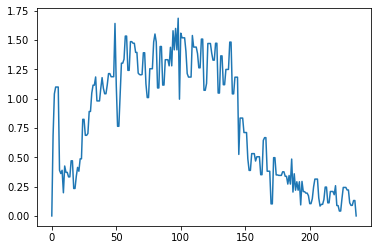

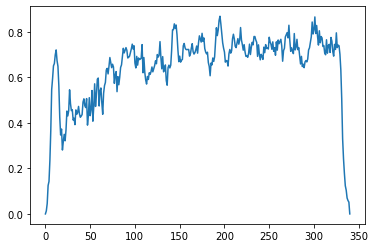

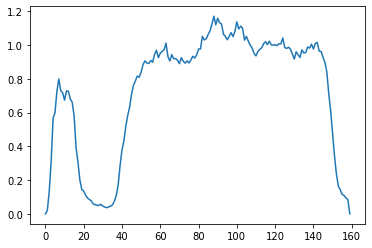

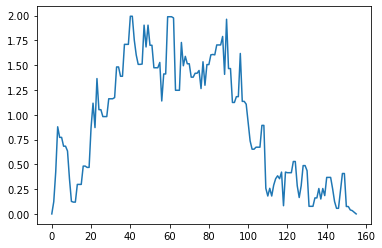

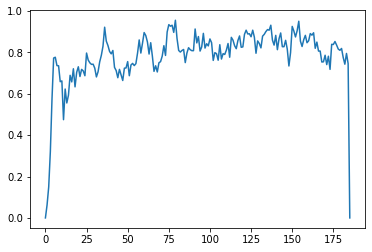

In [13]:
# plot some failed pumps
list_to_plot = labels_refined[labels_refined["PumpFailed"] == True].sample(5)["combination"].values
for l in list_to_plot:
    measurement_data = get_measurement_data(l)
    plt.figure()
    plt.plot(measurement_data)

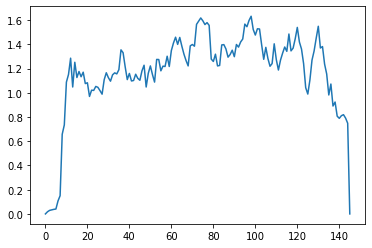

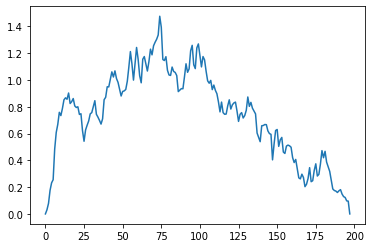

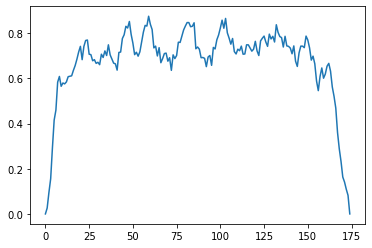

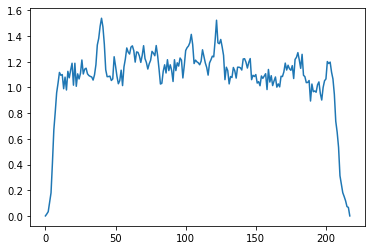

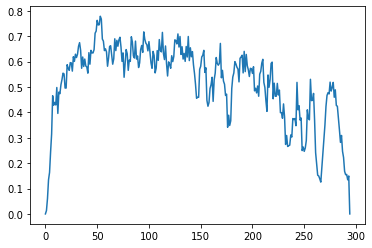

In [14]:
# plot some normal pumps
list_to_plot = labels_refined[labels_refined["PumpFailed"] == False].sample(5)["combination"].values
for l in list_to_plot:
    measurement_data = get_measurement_data(l)
    plt.figure()
    plt.plot(measurement_data)

Note: there are some clear differences 

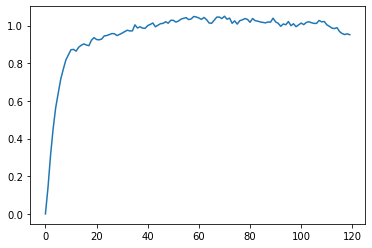

In [49]:
# plot aggregated normal pumps
list_to_plot = labels_refined[labels_refined["PumpFailed"] == False].sample(100)["combination"].values
measurement_data = [get_measurement_data(l)[0:120] for l in list_to_plot]
measurement_data = [m for m in measurement_data if m.shape[0]==120]
measurement_data = np.array(measurement_data)

plt.plot(measurement_data.mean(axis=0))
measurement_data_good = measurement_data.copy()

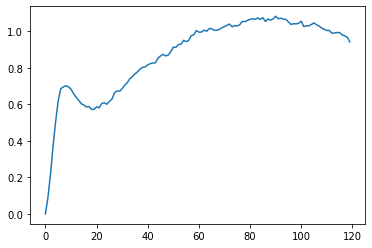

In [55]:
# plot aggregated failed pumps
list_to_plot = labels_refined[labels_refined["PumpFailed"] == True].sample(100)["combination"].values
measurement_data = [get_measurement_data(l)[0:120] for l in list_to_plot]
measurement_data = [m for m in measurement_data if m.shape[0]==120]
measurement_data = np.array(measurement_data)

plt.plot(measurement_data.mean(axis=0))
measurement_data_fail = measurement_data.copy()

In [56]:
print(measurement_data_fail[:,0:40].mean())
print(measurement_data_fail[:,40:80].mean())


0.6116570079989201
0.9601263383796688


Note: Aggregated mean in first 40 datapoints and following 40 datapoints can be used as feature.

In [108]:
# check max Pressure
df[df["MeasurementId"]!=-1].sort_values(by="Pressure", ascending=False)[0:20]

,MachineId,MeasurementId,Pressure
8182778,0_2_3,3711,5.778499
8182779,0_2_3,3711,5.778499
8094555,41_3_2,3659,4.846856
8094540,41_3_2,3659,4.779919
8094542,41_3_2,3659,4.694726
8094554,41_3_2,3659,4.681542
8094556,41_3_2,3659,4.669371
8094558,41_3_2,3659,4.656187
11543992,9_0_2,5379,4.636766
11543991,9_0_2,5379,4.636766


Note: I will apply normalization

Note:
- crop measurement data
- create features out of signal -> feature engineering


### Data transformation and cleaning
- labels:
    - drop nan
    - drop columns that we don't need
    - create new column "combination", which is our identifier of measurement

- df:
    - actualize get_measurement_data function
    - drop data for MeasurementID == -1


In [10]:
from sklearn.model_selection import train_test_split

# def get_measurement_data(combination):
#     (machine_id, measurement_id) = combination
#     new_df = df[(df["MachineId"]==machine_id) & (df["MeasurementId"]==measurement_id)]
#     measurement_data = new_df["Pressure"]
#     measurement_data = np.concatenate([[0], np.trim_zeros(measurement_data), [0]])
#     return measurement_data

## Transform label dataset:
labels_refined = labels.dropna(subset=["PumpFailed"]).copy()
labels_refined["combination"] = labels_refined[["MachineId", "MeasurementId"]].values.tolist()
labels_refined = labels_refined[["combination", "PumpFailed"]]

# Save testing data for later: 10%
data, test_data = train_test_split(labels_refined, test_size=0.1, random_state=42)

df = df[df["MeasurementId"] > -1]

### Feature engineering:
- **relative characteristics of the signal try to model/find:**
    - some number to determine how stable is it
    - max Amplitude
    - max. diff (negative) derivative + position
    - max. diff (positive) derivative + position
    - max. absolute diff    + position
    - min absolute diff     + position
    - noisiness (diff avg.)
    - features with filter / without filter


##### Explore features creation based on diff, gradient, add some easy filter
- create function to add experimental features into dataframe
- look for dependencies between failed pump and created features


In [52]:
data.head(10)

,combination,PumpFailed
23327,"[0_0_1, 7630]",False
12717,"[27_2_1, 4480]",False
19856,"[4_1_1, 6738]",False
2044,"[0_1_0, 848]",False
267,"[2_2_3, 94]",True
6152,"[27_0_2, 2447]",True
2535,"[4_0_3, 1053]",False
12970,"[27_0_2, 4565]",False
21627,"[0_2_0, 7194]",False
22334,"[0_0_0, 7375]",False


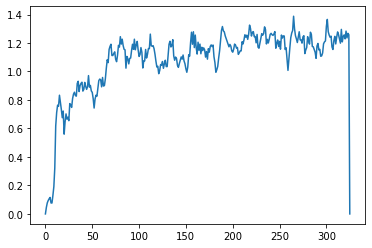

In [5]:
m_data = get_measurement_data(data.iloc[6]["combination"])
plt.plot(m_data)

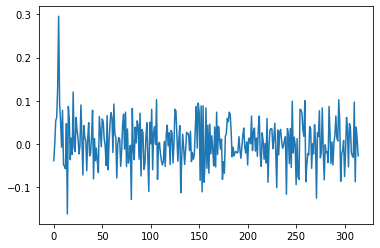

In [139]:
# diff
data_to_plot = np.diff(m_data[5:-5])
plt.plot(data_to_plot)

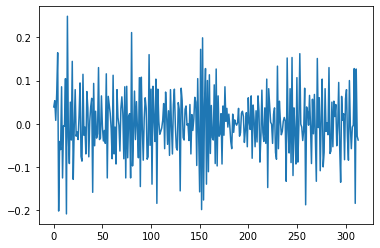

In [162]:
# diff 2
data_to_plot = np.diff(m_data[5:-5],2)
plt.plot(data_to_plot)

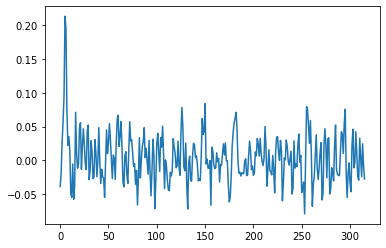

In [166]:
# grad
data_to_plot = np.gradient(m_data[5:-5])
plt.plot(data_to_plot)

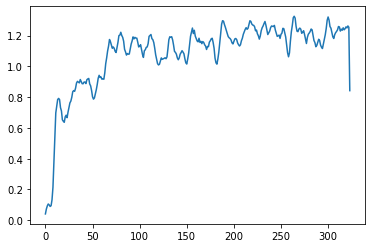

In [8]:
# apply easy filter
def apply_rolling_avg(m_data, n=3):
    return np.convolve(m_data, np.ones(n), "valid")/n

data_to_plot = apply_rolling_avg(m_data, 3)
plt.plot(data_to_plot)

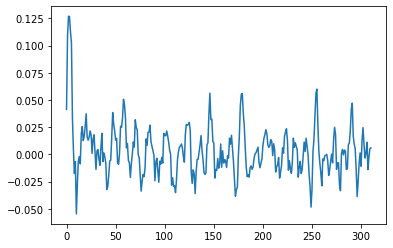

In [157]:
# apply rolling window avg. filter for diff
# data_to_plot = np.diff(apply_rolling_avg(m_data, 5)[5:-5])
data_to_plot = np.diff(m_data[5:-5])
data_to_plot = apply_rolling_avg(data_to_plot, 5)
plt.plot(data_to_plot)

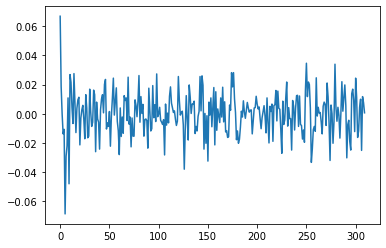

In [161]:
# apply rolling window avg. filter for diff
data_to_plot = np.diff(apply_rolling_avg(m_data, 5)[5:-5], 2)
data_to_plot = np.diff(m_data[5:-5], 2)
data_to_plot = apply_rolling_avg(data_to_plot, 5)
plt.plot(data_to_plot)

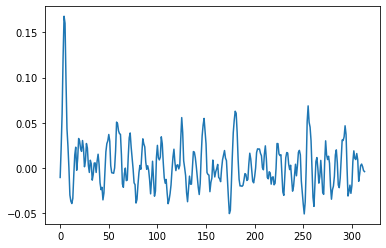

In [144]:
# apply rolling window avg. filter for gradient
data_to_plot = np.gradient(m_data[5:-5])
data_to_plot = apply_rolling_avg(data_to_plot, 3)
plt.plot(data_to_plot)

In [ ]:
print("features")
print(m_data.max()) # amplitude

m_diff = np.diff(m_data)
m_diff_max = m_diff[5:-5].max()
m_diff_min = m_diff[5:-5].min()

print("\ndiff features:")
print(np.where(m_diff == m_diff_max)[0][0]) # position of max diff
print(np.where(m_diff == m_diff_min)[0][0]) # position of min diff
print(m_diff_max)   # max diff
print(m_diff_min)   # min diff
print(np.abs(m_diff).mean())    # mean diff / noise lvl.

m_grad = np.gradient(m_data[5:-5])
m_grad_max = m_grad[5:-5].max()
m_grad_min = m_grad[5:-5].min()

print("\ngradient features:")
print(np.where(m_grad == m_grad_max)[0][0]) # position of max pos grad
print(np.where(m_grad == m_grad_min)[0][0]) # position of max neg grad
print(m_grad_max)   # max diff
print(m_grad_min)   # min diff

# apply filter:
m_data_filtered = apply_rolling_avg(m_data, 5)

# apply diff
m_diff = np.diff(m_data_filtered)
m_diff_max = m_diff[5:-5].max()
m_diff_min = m_diff[5:-5].min()

print("\ndiff features (on filtered):")
print(np.where(m_diff == m_diff_max)[0][0]) # position of max diff
print(np.where(m_diff == m_diff_min)[0][0]) # position of min diff
print(m_diff_max)   # max diff
print(m_diff_min)   # min diff
print(np.abs(m_diff).mean())    # mean diff / noise lvl.

##### Put everything together into function and run (without multiprocessing)
<br>Note: I tried to run this for subset but it took to long, 
- I re-wrote get_measurement_data to read directly from parquet as it was 2-times faster 
- I applied multiprocessing to speed this up
- It is still possible to make this much more time effective but I'm skipping that for now

In [3]:
# from sklearn.preprocessing import MinMaxScaler

# # apply easy filter
# def apply_rolling_avg(m_data, n=3):
#     return np.convolve(m_data, np.ones(n), "valid")/n

# def get_features_from_transformed(m_diff):
#     list_of_features = []
#     m_diff_max = m_diff.max()
#     m_diff_min = m_diff.min()

#     # create features from transformed:
#     list_of_features.append(np.where(m_diff == m_diff_max)[0][0]) # position of max diff
#     list_of_features.append(np.where(m_diff == m_diff_min)[0][0]) # position of min diff
#     list_of_features.append(m_diff_max)   # max diff
#     list_of_features.append(m_diff_min)   # min diff
#     list_of_features.append(np.abs(m_diff).mean())    # mean diff / noise lvl.
#     return list_of_features

# def create_features(m_data):  
#     list_of_features = []

#     # add amplitude
#     list_of_features.append(m_data.max())

#     # normalize
#     scaler = MinMaxScaler()
#     m_data = scaler.fit_transform(m_data.reshape(-1, 1)).T[0]

#     # raw data add diff and grad
#     m_diff = np.diff(m_data[5:-5])
#     m_grad = np.gradient(m_data[5:-5], axis=0)

#     # apply filter:
#     m_data_filtered = apply_rolling_avg(m_data, 5)

#     # filtered data add diff and diff2
#     m_f_diff = np.diff(m_data_filtered[5:-5])
#     m_f_diff2 = np.diff(m_diff)

#     transformed = [m_diff, m_grad, m_f_diff, m_f_diff2]

#     [list_of_features.extend(get_features_from_transformed(x)) for x in transformed]

#     return list_of_features

In [ ]:
# # Serialized / Standard computation
# data_subset = data
# data_subset["features"] = enrich_df(data_subset["combination"])
# data_subset.to_csv('dataframe.csv')

##### Put everyhting together and run with multiprocessing
- Save function used for feature engineering as .py file

In [7]:
%%writefile do_in_parallel.py
import numpy as np
import pandas as pd

from sklearn.preprocessing import MinMaxScaler

def enrich_df(key):
    m_data = get_measurement_data(key)
    # print(key)
    # return 0 for data with small amount of features
    if (m_data.shape[0]<20):
        return 0
    return create_features(m_data)
enrich_df_vect = np.vectorize(enrich_df, otypes=[np.ndarray])

def worker(df):
    return enrich_df_vect(df["combination"])

def get_measurement_data(combination):

    row_filters = [
        ('MachineId', '==', combination[0]), 
        ('MeasurementId', '==', combination[1])
    ]
    df = pd.read_parquet("data.parquet", columns=["Pressure"], filters=row_filters)
    measurement_data = df["Pressure"].values
    measurement_data = np.concatenate([[0], np.trim_zeros(measurement_data), [0]])
    return measurement_data

# apply easy filter
def apply_rolling_avg(m_data, n=3):
    return np.convolve(m_data, np.ones(n), "valid")/n

def get_features_from_transformed(m_diff):
    list_of_features = []
    m_diff_max = m_diff.max()
    m_diff_min = m_diff.min()

    # create features from transformed:
    list_of_features.append(np.where(m_diff == m_diff_max)[0][0]) # position of max diff
    list_of_features.append(np.where(m_diff == m_diff_min)[0][0]) # position of min diff
    list_of_features.append(m_diff_max)   # max diff
    list_of_features.append(m_diff_min)   # min diff
    list_of_features.append(np.abs(m_diff).mean())    # mean diff / noise lvl.
    return list_of_features

def create_features(m_data):  
    list_of_features = []

    # add amplitude
    list_of_features.append(m_data.max())

    # normalize
    scaler = MinMaxScaler()
    m_data = scaler.fit_transform(m_data.reshape(-1, 1)).T[0]

    # 
    if m_data.shape[0]>70:
        mean_0_30 = m_data[0:30].mean()
        mean_30_60 = m_data[30:60].mean()
    else:
        mean_0_30 = 0
        mean_30_60 = 0
    list_of_features.append(mean_0_30)
    list_of_features.append(mean_30_60)

    # raw data add diff and grad
    m_diff = np.diff(m_data[5:-5])
    m_grad = np.gradient(m_data[5:-5], axis=0)

    # apply filter:
    m_data_filtered = apply_rolling_avg(m_data, 5)

    # filtered data add diff and diff2
    m_f_diff = np.diff(m_data_filtered[5:-5])
    m_f_diff2 = np.diff(m_data_filtered[5:-5], 2)

    transformed = [m_diff, m_grad, m_f_diff, m_f_diff2]

    [list_of_features.extend(get_features_from_transformed(x)) for x in transformed]

    return list_of_features


Overwriting do_in_parallel.py


##### Enrich dataset:
- apply function

In [4]:
# def get_measurement_data(combination):

#     row_filters = [
#         ('MachineId', '==', combination[0]), 
#         ('MeasurementId', '==', combination[1])
#     ]
#     df = pd.read_parquet("data.parquet", columns=["Pressure"], filters=row_filters)
#     measurement_data = df["Pressure"].values
#     measurement_data = np.concatenate([[0], np.trim_zeros(measurement_data), [0]])
#     return measurement_data

# def enrich_df(key):
#     m_data = get_measurement_data(key)
#     # print(key)
#     # return 0 for data with small amount of features
#     if (m_data.shape[0]<20):
#         return 0
#     return create_features(m_data)
# enrich_df = np.vectorize(enrich_df, otypes=[np.ndarray])

In [4]:
# import do_in_parallel

# from multiprocessing import Pool
# from timeit import default_timer as timer

# #Create sizes for 3 arrays. 
# data_subset = data[0:50]
# data_list = np.array_split(data_subset, 7)
# #Applying the function sequentially
# tic = timer()
# data_subset["features"] = do_in_parallel.worker(data_subset)
# tac = timer()
# print("time for sequential sorting: ", tac-tic)
# #Using multiprocessing
# if __name__ == "__main__":
#     pool = Pool(processes=7)
#     tic = timer()
#     results = pool.map(do_in_parallel.worker,data_list)
#     pool.close()
#     pool.join()
#     tac = timer()
#     print("time for parallel sorting: ",tac-tic)

# for df, result in zip(data_list, results):
#     df["features"] = result
# data_subset2 = pd.concat(data_list)

time for sequential sorting:  63.1783241
time for parallel sorting:  37.02879969999998


Note: coommented code is how I tested if multiprocessing is faster here

In [11]:
from multiprocessing import Pool
import do_in_parallel

#split data into 7 pieces:
data_list = np.array_split(data, 7)

#Using multiprocessing
if __name__ == "__main__":
    pool = Pool(processes=7)
    results = pool.map(do_in_parallel.worker,data_list)
    pool.close()
    pool.join()

#join results:
for df, result in zip(data_list, results):
    df["features"] = result
data = pd.concat(data_list)
data.to_csv('dataframe_parallel.csv')

In [22]:
# import dask.dataframe as dd
# from dask.dataframe import from_pandas

# data_subset["features"] = [ [] for _ in range(data_subset.shape[0]) ]

# ddf = from_pandas(data_subset, npartitions=5)
# res = ddf["combination"].map_partitions(enrich_df, meta=data_subset["features"])
# data_subset["features"] = res.compute()

C:\Users\P5787~1.HUD\AppData\Local\Temp/ipykernel_10800/2403981075.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_subset["features"] = res.compute()


Note: this took a lot of time
[4+ hours mark.]
+ computation time


### Visualize dependencies:
- features are ready, let's see if they are meaningfull

In [80]:
import pandas as pd
from ast import literal_eval

data = pd.read_csv("dataframe_parallel.csv", index_col=0)
data['features'] = data['features'].apply(literal_eval)
data = data[data['features']!=0]

column_list = [f"f_{i}" for i in range(1, 24)]

split_df = pd.DataFrame(data['features'].tolist(), columns=column_list)
data = pd.concat([data.reset_index(drop=True), split_df], axis=1)
# data.head()


In [16]:
import plotly.express as px

for feature in column_list:
    fig = px.box(data, x="PumpFailed", y=feature, width=800, height=400)
    fig.show()

Note: Some features seems to not be useful and there are also lot of outliers.

In [81]:
# dropping columns that doesn't seems useful
data = data.drop(columns=['f_5', 'f_10', 'f_11', 'f_12', 'f_13', 'f_15', 'f_17', 'f_18'])

# drop also feature
data = data.drop(columns=['features'])


In [82]:
# correlation between features:
corr_matrix = data.corr(method ='pearson').abs()
corr_matrix

,PumpFailed,f_1,f_2,f_3,f_4,f_6,f_7,f_8,f_9,f_14,f_16,f_19,f_20,f_21,f_22,f_23
PumpFailed,1.000000,0.057063,0.266155,0.159250,0.035099,0.074742,0.092283,0.059802,0.063798,0.070996,0.088419,0.033713,0.045445,0.078647,0.081810,0.078987
f_1,0.057063,1.000000,0.240030,0.201965,0.184191,0.071815,0.006948,0.166351,0.143576,0.137802,0.140671,0.211561,0.202820,0.049917,0.071566,0.095132
f_2,0.266155,0.240030,1.000000,0.651312,0.203352,0.123033,0.074385,0.100518,0.199913,0.136390,0.346197,0.151692,0.133767,0.126177,0.110829,0.085121
f_3,0.159250,0.201965,0.651312,1.000000,0.251774,0.276945,0.285847,0.221289,0.278013,0.239540,0.303482,0.137136,0.077453,0.319296,0.302619,0.226408
f_4,0.035099,0.184191,0.203352,0.251774,1.000000,0.234210,0.196703,0.257144,0.637463,0.558631,0.129633,0.539459,0.500628,0.279818,0.257610,0.258115
f_6,0.074742,0.071815,0.123033,0.276945,0.234210,1.000000,0.703649,0.807627,0.322856,0.224953,0.588330,0.068374,0.047073,0.821498,0.808860,0.831370
f_7,0.092283,0.006948,0.074385,0.285847,0.196703,0.703649,1.000000,0.609551,0.274772,0.190779,0.512099,0.024168,0.007615,0.866446,0.865434,0.640826
f_8,0.059802,0.166351,0.100518,0.221289,0.257144,0.807627,0.609551,1.000000,0.316107,0.221549,0.453468,0.079481,0.007589,0.734528,0.720007,0.979083
f_9,0.063798,0.143576,0.199913,0.278013,0.637463,0.322856,0.274772,0.316107,1.000000,0.583485,0.184328,0.435977,0.384230,0.350566,0.331165,0.329040
f_14,0.070996,0.137802,0.136390,0.239540,0.558631,0.224953,0.190779,0.221549,0.583485,1.000000,0.079954,0.470328,0.433304,0.259235,0.244826,0.232615


In [83]:
list(set(data.columns.to_list()) - set(["combination", "PumpFailed"]))

['f_7',
 'f_2',
 'f_6',
 'f_22',
 'f_9',
 'f_14',
 'f_1',
 'f_20',
 'f_16',
 'f_3',
 'f_21',
 'f_19',
 'f_4',
 'f_23',
 'f_8']

In [84]:
threshold = 0.85

def high_cor_function(df):
    cor = df.corr()
    corrm = np.corrcoef(df.transpose())
    corr = corrm - np.diagflat(corrm.diagonal())
    print("max corr:",corr.max(), ", min corr: ", corr.min())
    c1 = cor.stack().sort_values(ascending=False).drop_duplicates()
    high_cor = c1[c1.values!=1]    
    thresh = threshold 
    display(high_cor[high_cor>thresh])

actual_feature_list = list(set(data.columns.to_list()) - set(["combination", "PumpFailed"]))
high_cor_function(data[actual_feature_list])

max corr: 0.9790826417917842 , min corr:  -0.8728285011049485


f_8  f_23    0.979083
f_7  f_22    0.865434
dtype: float64

In [85]:
columns_to_drop = ['f_23', 'f_22']
data = data.drop(columns=columns_to_drop)

### Modeling:

##### Data prep. for modeling:

In [86]:
def remove_outliers(df, cols_list):
    Q1 = df[cols_list].quantile(0.25)
    Q3 = df[cols_list].quantile(0.75)
    IQR = Q3 - Q1
    df = df[~((df[cols_list] < (Q1 - 1.5 * IQR)) |(df[cols_list] > (Q3 + 1.5 * IQR))).any(axis=1)]
    return df

column_list = list(set(data.columns) - set(['combination', 'PumpFailed']))
data = remove_outliers(data, column_list)
data

,combination,PumpFailed,f_1,f_2,f_3,f_4,f_6,f_7,f_8,f_9,f_14,f_16,f_19,f_20,f_21
0,"['0_0_1', 7630]",False,1.146919,0.482590,0.782507,125,0.100000,-0.097521,0.031168,5,1,0.062149,173,132,0.037521
1,"['27_2_1', 4480]",False,1.295295,0.695312,0.672875,216,0.153014,-0.183153,0.034031,0,212,0.066461,210,216,0.040804
2,"['4_1_1', 6738]",False,1.234409,0.575407,0.813473,0,0.139373,-0.195993,0.032314,0,0,0.064460,113,209,0.029443
4,"['2_2_3', 94]",True,0.563500,0.498442,0.684752,0,0.332220,-0.275459,0.061535,0,17,0.073122,164,0,0.061102
5,"['27_0_2', 2447]",True,0.879056,0.265063,0.477330,34,0.182327,-0.168904,0.039718,35,34,0.094855,115,2,0.054810
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24132,"['9_5_3', 4178]",False,1.352295,0.421673,0.808930,18,0.291513,-0.350554,0.059441,19,22,0.069815,44,39,0.070111
24133,"['36_2_2', 4393]",False,1.500541,0.402978,0.786984,2,0.139049,-0.200288,0.037770,3,2,0.073631,7,2,0.045677
24134,"['4_3_1', 7301]",False,1.167647,0.681696,0.852393,31,0.117548,-0.192275,0.034615,0,27,0.037951,26,190,0.034761
24135,"['25_0_2', 2258]",False,1.163599,0.621851,0.835062,102,0.229350,-0.174868,0.053568,0,5,0.057821,97,156,0.055009


In [87]:
# for feature in column_list[0:3]:
#     fig = px.box(data, x="PumpFailed", y=feature, width=800, height=400)
#     fig.show()

In [88]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import ColumnTransformer

num_pipeline = Pipeline([
        ('std_scaler', StandardScaler()),
    ])

full_pipeline = ColumnTransformer([
        ("num", num_pipeline, column_list),
    ])

In [89]:
data[(column_list+['PumpFailed'])]

,f_20,f_7,f_3,f_21,f_19,f_2,f_6,f_9,f_4,f_14,f_1,f_16,f_8,PumpFailed
0,132,-0.097521,0.782507,0.037521,173,0.482590,0.100000,5,125,1,1.146919,0.062149,0.031168,False
1,216,-0.183153,0.672875,0.040804,210,0.695312,0.153014,0,216,212,1.295295,0.066461,0.034031,False
2,209,-0.195993,0.813473,0.029443,113,0.575407,0.139373,0,0,0,1.234409,0.064460,0.032314,False
4,0,-0.275459,0.684752,0.061102,164,0.498442,0.332220,0,0,17,0.563500,0.073122,0.061535,True
5,2,-0.168904,0.477330,0.054810,115,0.265063,0.182327,35,34,34,0.879056,0.094855,0.039718,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24132,39,-0.350554,0.808930,0.070111,44,0.421673,0.291513,19,18,22,1.352295,0.069815,0.059441,False
24133,2,-0.200288,0.786984,0.045677,7,0.402978,0.139049,3,2,2,1.500541,0.073631,0.037770,False
24134,190,-0.192275,0.852393,0.034761,26,0.681696,0.117548,0,31,27,1.167647,0.037951,0.034615,False
24135,156,-0.174868,0.835062,0.055009,97,0.621851,0.229350,0,102,5,1.163599,0.057821,0.053568,False


In [90]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(data[column_list+['PumpFailed']], data['PumpFailed'], test_size=0.2, random_state=42)

X_train = full_pipeline.fit_transform(X_train)
X_test = full_pipeline.transform(X_test)

##### Training, compare estimators:
- We need to decide what will be our main metric - how we will evaluate model's performance (in real use-case we should set this based on expected goals from customer/ expected usage of model)
    - recall if the main goal is to catch as many as possible failures
    - precission if customer wants to be sure that if model label something as failure - it is a failure
    - balanced accuracy or f_1 or ROC_AUC metrics for combination
    - last option is to resample both classess and use classic Accuracy

In [94]:
def printout_metric(y_train_hat, y_train, y_test_hat, y_test):
    print('\nTrain:')
    print(confusion_matrix(y_train, y_train_hat))
    print(f'Recall: {recall_score(y_train, y_train_hat)}')
    print(f'Precission: {precision_score(y_train, y_train_hat)}')
    print(f'ROC_AUC: {roc_auc_score(y_train, y_train_hat)}')

    print('\nTest:')
    print(confusion_matrix(y_test, y_test_hat))
    print(f'Recall: {recall_score(y_test, y_test_hat)}')
    print(f'Precission: {precision_score(y_test, y_test_hat)}')
    print(f'ROC_AUC: {roc_auc_score(y_test, y_test_hat)}')
    return 0

In [95]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, recall_score, roc_auc_score, precision_score

cls = LogisticRegression()
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)


Train:
[[13335   179]
 [ 1151   306]]
Recall: 0.21002059025394645
Precission: 0.6309278350515464
ROC_AUC: 0.5983875335463901

Test:
[[3321   36]
 [ 322   64]]
Recall: 0.16580310880829016
Precission: 0.64
ROC_AUC: 0.5775396241092389


0

In [96]:
from sklearn.ensemble import RandomForestClassifier

cls = RandomForestClassifier(n_estimators=100, max_depth=15, class_weight = "balanced")
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)


Train:
[[13431    83]
 [   18  1439]]
Recall: 0.9876458476321208
Precission: 0.9454664914586071
ROC_AUC: 0.9907520343680806

Test:
[[3305   52]
 [ 256  130]]
Recall: 0.33678756476683935
Precission: 0.7142857142857143
ROC_AUC: 0.660648771957444


0

Note: overfitting, imbalanced classes, 

##### Resample data + crossvalidation

In [97]:
from sklearn.utils import resample
from sklearn.model_selection import cross_val_score

# Resample
data_majority = data[data["PumpFailed"]==False]
data_minority = data[data["PumpFailed"]==True]
 
# Downsample majority class
df_majority_downsampled = resample(data_majority, 
                                 replace=False,    
                                 n_samples=10000)
#Upsample minority class
df_minority_upsampled = resample(data_minority, 
                                 replace=True,     
                                 n_samples=10000)
# Combine minority class with downsampled majority class
df_up_down_sampled = pd.concat([df_majority_downsampled, df_minority_upsampled])


from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(df_up_down_sampled[column_list+['PumpFailed']], df_up_down_sampled['PumpFailed'], test_size=0.2, random_state=42)

X_train = full_pipeline.fit_transform(X_train)
X_test = full_pipeline.transform(X_test)

In [98]:
# logistic regression:

cls = LogisticRegression()
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)

# random forrest
cls = RandomForestClassifier(n_estimators=100, max_depth=15)
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)


Train:
[[6249 1732]
 [2060 5959]]
Recall: 0.7431101134804838
Precission: 0.7748017162917696
ROC_AUC: 0.7630473509389638

Test:
[[1557  462]
 [ 472 1509]]
Recall: 0.7617364967188289
Precission: 0.7656012176560122
ROC_AUC: 0.7664551725793254

Train:
[[7941   40]
 [  10 8009]]
Recall: 0.9987529617159246
Precission: 0.9950304385637967
ROC_AUC: 0.9968705292228288

Test:
[[1895  124]
 [  14 1967]]
Recall: 0.9929328621908127
Precission: 0.9406982305117169
ROC_AUC: 0.9657581596739105


0

Note: 
- By upsampling I'm causing data leakage that is why confusion matrix looks so good. 
- Cverfitting so lowering down depth of trees.

In [99]:
# train-test split
df_train, df_test = train_test_split(data, test_size=0.2, random_state=42)

# Resample
data_majority = df_train[df_train["PumpFailed"]==False]
data_minority = df_train[df_train["PumpFailed"]==True]
 
# Downsample majority class
df_majority_downsampled = resample(data_majority, 
                                 replace=False,    
                                 n_samples=8000)
#Upsample minority class
df_minority_upsampled = resample(data_minority, 
                                 replace=True,     
                                 n_samples=8000)
# Combine minority class with downsampled majority class
df_up_down_sampled = pd.concat([df_majority_downsampled, df_minority_upsampled])

X_train = df_up_down_sampled[column_list]
y_train = df_up_down_sampled['PumpFailed']
X_test = df_test[column_list]
y_test = df_test['PumpFailed']

X_train = full_pipeline.fit_transform(X_train)
X_test = full_pipeline.transform(X_test)

In [100]:
# logistic regression:
cls = LogisticRegression()
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)


# random forrest
cls = RandomForestClassifier(n_estimators=100, max_depth=5, class_weight = "balanced")
cls.fit(X_train,y_train)
y_train_hat = cls.predict(X_train)
y_test_hat = cls.predict(X_test)

printout_metric(y_train_hat, y_train, y_test_hat, y_test)


Train:
[[6254 1746]
 [2037 5963]]
Recall: 0.745375
Precission: 0.7735114800882086
ROC_AUC: 0.7635625

Test:
[[2625  732]
 [ 110  276]]
Recall: 0.7150259067357513
Precission: 0.27380952380952384
ROC_AUC: 0.7484870373714503

Train:
[[6522 1478]
 [1605 6395]]
Recall: 0.799375
Precission: 0.8122697828019815
ROC_AUC: 0.8073125

Test:
[[2686  671]
 [  98  288]]
Recall: 0.7461139896373057
Precission: 0.30031282586027114
ROC_AUC: 0.7731165718219296


0

Note: Random forrest is slightly better on test set but logistic regression is simpler model with no overfiting tendencies.

### 6 hours mark! Next steps:
- Back to feature engineering:
    - discuss Feature engineering with someone (expert from customer side / colleague who work a lot with signals or domain)
    - if time allows try to find additional information about measurements
    - Create new features -> this is the most important part of problem!
    - use name of device as categorical feature (only for devices with botch classes of records, put rest into "other" category)

- Modeling:
    - round values in num features to 0.01 - to help with overfitting (in random forrest)
    - find best estimators and best params with grid search + crossvalidation

- Save "artifacts", push into repo:

- Deploy model as rest API:


### Save model + preprocessing pipeline + function to create features from measurements

In [101]:
import joblib

#train model
cls = LogisticRegression()
cls.fit(X_train,y_train)

joblib.dump(full_pipeline, "app/full_pipeline.pkl")
joblib.dump(cls, "app/model.pkl")



['app/model.pkl']

In [105]:
data.columns

Index(['combination', 'PumpFailed', 'f_1', 'f_2', 'f_3', 'f_4', 'f_6', 'f_7',
       'f_8', 'f_9', 'f_14', 'f_16', 'f_19', 'f_20', 'f_21'],
      dtype='object')

In [112]:
%%writefile app/feature_engineering.py
import numpy as np
import pandas as pd

from sklearn.preprocessing import MinMaxScaler

def transform_measurement_data(measurement_data):
    measurement_data = np.concatenate([[0], np.trim_zeros(measurement_data), [0]])
    if (measurement_data.shape[0]<20):
        return 0
    return create_features(measurement_data)

# apply easy filter
def apply_rolling_avg(m_data, n=3):
    return np.convolve(m_data, np.ones(n), "valid")/n

def get_features_from_transformed(m_diff):
    list_of_features = []
    m_diff_max = m_diff.max()
    m_diff_min = m_diff.min()

    # create features from transformed:
    list_of_features.append(np.where(m_diff == m_diff_max)[0][0]) # position of max diff
    list_of_features.append(np.where(m_diff == m_diff_min)[0][0]) # position of min diff
    list_of_features.append(m_diff_max)   # max diff
    list_of_features.append(m_diff_min)   # min diff
    list_of_features.append(np.abs(m_diff).mean())    # mean diff / noise lvl.
    return list_of_features

def create_features(m_data):  
    list_of_features = []

    # add amplitude
    list_of_features.append(m_data.max())

    # normalize
    scaler = MinMaxScaler()
    m_data = scaler.fit_transform(m_data.reshape(-1, 1)).T[0]

    # 
    if m_data.shape[0]>70:
        mean_0_30 = m_data[0:30].mean()
        mean_30_60 = m_data[30:60].mean()
    else:
        mean_0_30 = 0
        mean_30_60 = 0
    list_of_features.append(mean_0_30)
    list_of_features.append(mean_30_60)

    # raw data add diff and grad
    m_diff = np.diff(m_data[5:-5])
    m_grad = np.gradient(m_data[5:-5], axis=0)

    # apply filter:
    m_data_filtered = apply_rolling_avg(m_data, 5)

    # filtered data add diff and diff2
    m_f_diff = np.diff(m_data_filtered[5:-5])
    m_f_diff2 = np.diff(m_data_filtered[5:-5], 2)

    transformed = [m_diff, m_grad, m_f_diff, m_f_diff2]

    [list_of_features.extend(get_features_from_transformed(x)) for x in transformed]

    return list_of_features


Overwriting app/feature_engineering.py


In [103]:
test_data

,combination,PumpFailed
24456,"[0_1_2, 7953]",False
21836,"[0_2_0, 7247]",False
8094,"[0_0_1, 3119]",True
20993,"[4_2_0, 7029]",False
13269,"[14_0_0, 4655]",False
...,...,...
4174,"[0_1_2, 1731]",False
10218,"[4_0_0, 3769]",False
17660,"[0_0_3, 6139]",False
8377,"[3_1_1, 3206]",False


In [117]:
from app import feature_engineering
features = feature_engineering.transform_measurement_data(measurement_data)

In [9]:
# import do_in_parallel
# import joblib
# from app import feature_engineering

# my_model_loaded = joblib.load("app/model.pkl")
# my_pipeline_loaded = joblib.load("app/full_pipeline.pkl")


# measurement_data = do_in_parallel.get_measurement_data(test_data["combination"].iloc[0])


# features = feature_engineering.transform_measurement_data(measurement_data)
# features = feature
# features = my_pipeline_loaded.transform(np.array(features))

IndexError: tuple index out of range